# CartPole — Apprentissage par renforcement avec approximation de fonctions

[![Ouvrir Sur Colab](https://colab.research.google.com/assets/colab-badge.svg)](https://colab.research.google.com/drive/1z3CBO5QQ47rQ9lDMaTPbs5HsElG2mgfh)


Ce notebook explore différents algorithmes d’**Apprentissage par Renforcement (RL)** appliqués à
l’environnement **CartPole-v1** de Gymnasium.  
Il montre comment gérer des **états continus** à l’aide de **TensorFlow (Keras)** pour
l’approximation de fonctions (value et action-value).

Algorithmes implémentés :
- **SARSA** — Apprentissage on-policy de Q(s, a)
- **Q-Learning** — Apprentissage off-policy de Q(s, a)
- **REINFORCE** — Policy gradient basé sur des épisodes complets
- **Actor–Critic** — Méthode combinant policy et value networks (avantage A(s, a))

Caractéristiques principales :
- Utilise **Gymnasium** (successeur de `gym`) pour une interface moderne et stable.
- Garde l’espace d’état **continu**, en utilisant de petits réseaux de neurones (MLP) pour approximer V(s) ou Q(s, a).
- Conçu pour un usage **éducatif et expérimental**, fonctionnant sur **CPU** sans besoin de GPU.
- Chaque algorithme est implémenté **from scratch** pour la clarté et la compréhension.
- Pour des résultats reproductibles : fixer les seeds et ajuster le nombre d’épisodes selon la machine.

## 0. Chargement des bibliotheques necessaires

In [1]:
import gymnasium as gym
import numpy as np
import tensorflow as tf
from tensorflow.keras import layers, optimizers, models
import matplotlib.pyplot as plt
import imageio
from IPython.display import HTML
from matplotlib import animation
from tqdm import tqdm
from collections import deque
import random

2025-11-04 20:19:02.452732: I external/local_xla/xla/tsl/cuda/cudart_stub.cc:31] Could not find cuda drivers on your machine, GPU will not be used.
2025-11-04 20:19:02.454774: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off, set the environment variable `TF_ENABLE_ONEDNN_OPTS=0`.
2025-11-04 20:19:02.658074: I tensorflow/core/platform/cpu_feature_guard.cc:210] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 AVX_VNNI FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2025-11-04 20:19:07.786883: I tensorflow/core/util/port.cc:153] oneDNN custom operations are on. You may see slightly different numerical results due to floating-point round-off errors from different computation orders. To turn them off,

## 1. Exploration de l'environnement CartPole

[CartPole](https://gymnasium.farama.org/environments/classic_control/cart_pole/) est un environnement de contrôle classique dans l'apprentissage par renforcement, **faisant partie de la nouvelle bibliothèque [Gymnasium](https://gymnasium.farama.org/) d'OpenAI**. L'objectif est d'équilibrer un poteau attaché à un chariot qui se déplace le long d'une piste.

<img src="https://miro.medium.com/max/600/1*v8KcdjfVGf39yvTpXDTCGQ.gif" width="45.5%" />

<img src="https://imgs.search.brave.com/WZ8YYAWJKo-L9N3w1KtCOEcAYqxUr7QytuTa6XuaNHs/rs:fit:860:0:0:0/g:ce/aHR0cHM6Ly9naXRo/dWIuY29tL2xlb25q/b3Zhbm92aWMvZHJs/LXBvbGljeS1ncmFk/aWVudC1jYXJ0cG9s/ZS9yYXcvbWFpbi9p/bWFnZXMvY2FydHBv/bGVfZW52LnBuZw" width="52%" />

- **Observation (state)** : vecteur continu de dimension 4 :
  1. `x` : cart position (≈ range `[-4.8, 4.8]`)
  2. `x_dot` : cart velocity (unbounded en théorie)
  3. `θ` (theta) : pole angle (≈ range `[-0.418, 0.418]` radians ≈ ±24°)
  4. `θ_dot` : pole angular velocity (unbounded en théorie)
— Les deux dernières composantes (angle, angular velocity) sont généralement les plus informatives pour maintenir le pole upright.
- **Action space** : discret, 2 actions (`0` = push left, `1` = push right).
- **Reward** : +1 pour chaque step où le pole est maintenu ; objectif d’obtenir la plus longue durée possible (max 500 steps par épisode pour `CartPole-v1` by default).
- **Termination** : episode termine si `|x| > 4.8` (cart out of bounds) ou `|θ| > 0.418` rad (pole fallen) — Gymnasium retourne `terminated=True`. `truncated=True` si épisode atteint `max_episode_steps`.

In [3]:
env = gym.make('CartPole-v1', render_mode=None)
print('Observation space:', env.observation_space)
print('Action space:', env.action_space)
obs, info = env.reset()
print('Initial observation:', obs)
print("-"*20)
for _ in range(5):
    a = env.action_space.sample()
    obs, r, terminated, truncated, info = env.step(a)
    print('action:', a, '\t-> obs:', obs, '\treward:', r, '\tdone?:', terminated or truncated)
env.close()

Observation space: Box([-4.8               -inf -0.41887903        -inf], [4.8               inf 0.41887903        inf], (4,), float32)
Action space: Discrete(2)
Initial observation: [ 0.04551922 -0.00795298  0.0025153  -0.02996406]
--------------------
action: 1 	-> obs: [ 0.04536016  0.1871328   0.00191602 -0.32185233] 	reward: 1.0 	done?: False
action: 0 	-> obs: [ 0.04910282 -0.00801637 -0.00452103 -0.02856577] 	reward: 1.0 	done?: False
action: 0 	-> obs: [ 0.04894249 -0.2030732  -0.00509234  0.2626873 ] 	reward: 1.0 	done?: False
action: 1 	-> obs: [ 0.04488103 -0.00787893  0.0001614  -0.03159745] 	reward: 1.0 	done?: False
action: 1 	-> obs: [ 0.04472345  0.1872407  -0.00047054 -0.32422945] 	reward: 1.0 	done?: False


## 2. Fonctions utilitaires

Nous definissons 3 fonctions utilitaires:
- `build_mlp`: Construit un petit réseau de neurones multicouches (MLP) pour l'approximation de fonctions.
- `plot_reward`: Trace la courbe de récompense lissée au fil des épisodes pour visualiser l'apprentissage.
- `record_policy`: Enregistre une vidéo de la politique de l'agent dans l'environnement.

In [4]:
def build_mlp(input_dim, output_dim, hidden_sizes=(32,32), activation='relu'):
    model = models.Sequential()
    model.add(layers.Input(shape=(input_dim,)))
    for h in hidden_sizes:
        model.add(layers.Dense(h, activation=activation))
    model.add(layers.Dense(output_dim, activation=None))
    return model

In [5]:
def plot_rewards(list_of_rewards, labels, title="Courbes d'apprentissage"):
    plt.figure(figsize=(8,4))
    for rewards, label in zip(list_of_rewards, labels):
        # smooth
        w = max(1, len(rewards)//50)
        smooth = np.convolve(rewards, np.ones(w)/w, mode='valid')
        plt.plot(smooth, label=label)
    plt.legend()
    plt.xlabel('Épisodes')
    plt.ylabel('Récompense totale')
    plt.title(title)
    plt.show()

In [6]:
def record_policy(model, model_type='q', max_steps=500):
    env = gym.make('CartPole-v1', render_mode='rgb_array')
    obs, info = env.reset()
    frames = []

    for _ in range(max_steps):
        frames.append(env.render())
        qs = model(obs.reshape(1, -1).astype(np.float32)).numpy()[0]
        a = int(np.argmax(qs))
        obs, r, term, trunc, info = env.step(a)
        if term or trunc:
            frames.append(env.render())
            break
    env.close()

    fig = plt.figure()
    im = plt.imshow(frames[0])

    def animate(i):
        im.set_array(frames[i])
        return [im]

    anim = animation.FuncAnimation(fig, animate, frames=len(frames), interval=30)
    plt.close(fig)
    return HTML(anim.to_jshtml())

## 3. Temporal learning

In [7]:
def discretize_state(state, bins):
    """Convert continuous state to discrete tuple index."""
    return tuple(np.digitize(s, b) for s, b in zip(state, bins))

In [8]:
def record_policy_sarsa_q_learning(model, model_type='q', max_steps=500):
    env = gym.make('CartPole-v1', render_mode='rgb_array')
    obs, info = env.reset()
    frames = []

    for _ in range(max_steps):
        frames.append(env.render())
        qs = model(obs.reshape(1, -1).astype(np.float32)).numpy()[0]
        a = int(np.argmax(qs))
        obs, r, term, trunc, info = env.step(a)
        if term or trunc:
            frames.append(env.render())
            break
    env.close()

    # Créer une animation matplotlib
    fig = plt.figure()
    im = plt.imshow(frames[0])

    def animate(i):
        im.set_array(frames[i])
        return [im]

    anim = animation.FuncAnimation(fig, animate, frames=len(frames), interval=30)
    plt.close(fig)
    return HTML(anim.to_jshtml())

In [9]:
def train_value_based(method='q_learning', episodes=1000, gamma=0.99, alpha=0.001,
                      eps_0=1.0, eps_min=0.05, k=0.0009):
    env = gym.make('CartPole-v1')
    n_states = env.observation_space.shape[0]
    n_actions = env.action_space.n
    model = build_mlp(n_states, n_actions)
    optimizer = optimizers.Adam(alpha)
    loss_fn = tf.keras.losses.MeanSquaredError()

    rewards_history = []

    for ep in tqdm(range(episodes), desc=f"Training {method.upper()}"):
        obs, info = env.reset()
        eps = max(eps_min, eps_0 - k * ep)
        total_reward = 0
        done = False

        # choisir action initiale
        qs = model(obs.reshape(1, -1)).numpy()[0]
        if np.random.rand() < eps:
            action = np.random.randint(n_actions)
        else:
            action = np.argmax(qs)

        while not done:
            next_obs, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated
            total_reward += reward

            # choisir action suivante selon la politique epsilon-greedy
            next_qs = model(next_obs.reshape(1, -1)).numpy()[0]
            if np.random.rand() < eps:
                next_action = np.random.randint(n_actions)
            else:
                next_action = np.argmax(next_qs)

            # calcul de la cible (target)
            if method == 'sarsa':
                target = reward + (0 if done else gamma * next_qs[next_action])
            else:  # q_learning
                target = reward + (0 if done else gamma * np.max(next_qs))

            # apprentissage (mise à jour du modèle)
            with tf.GradientTape() as tape:
                q_values = model(obs.reshape(1, -1))
                q_pred = q_values[0, action]
                loss = loss_fn([[target]], [[q_pred]])
            grads = tape.gradient(loss, model.trainable_variables)
            optimizer.apply_gradients(zip(grads, model.trainable_variables))

            obs = next_obs
            action = next_action if method == 'sarsa' else np.argmax(next_qs)

        rewards_history.append(total_reward)

    env.close()
    return model, rewards_history

In [10]:
episodes = 800
sarsa_model, sarsa_rewards = train_value_based('sarsa', episodes=episodes)
q_model, q_rewards = train_value_based('q_learning', episodes=episodes)

2025-11-04 20:19:37.954722: E external/local_xla/xla/stream_executor/cuda/cuda_platform.cc:51] failed call to cuInit: INTERNAL: CUDA error: Failed call to cuInit: UNKNOWN ERROR (303)
Training Q_LEARNING: 100%|██████████| 800/800 [1:36:59<00:00,  7.27s/it]  


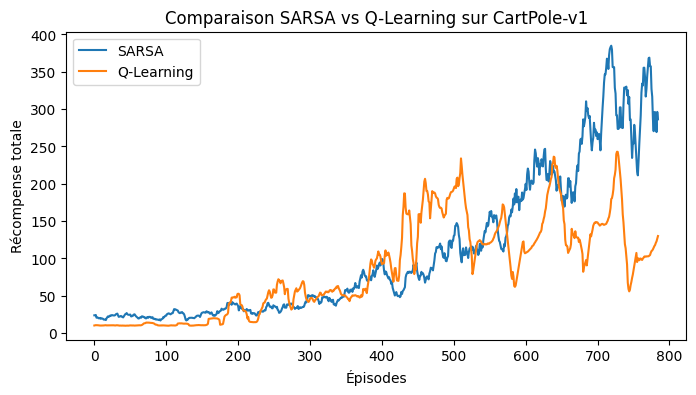

In [11]:
plot_rewards(
    list_of_rewards=[sarsa_rewards, q_rewards],
    labels=['SARSA', 'Q-Learning'],
    title="Comparaison SARSA vs Q-Learning sur CartPole-v1"
)

In [13]:
record_policy(q_model, model_type='q', max_steps=2_000)

/home/beria/Documents/RL-workshop/.venv/lib/python3.12/site-packages/pygame/pkgdata.py:25: UserWarning: pkg_resources is deprecated as an API. See https://setuptools.pypa.io/en/latest/pkg_resources.html. The pkg_resources package is slated for removal as early as 2025-11-30. Refrain from using this package or pin to Setuptools<81.
  from pkg_resources import resource_stream, resource_exists


In [14]:
record_policy(sarsa_model, model_type='sarsa', max_steps=2_000)

## 4. Policy gradient methods

In [15]:
def train_reinforce(episodes=500, gamma=0.99, lr=1e-3):
    env = gym.make('CartPole-v1')
    n_states = env.observation_space.shape[0]
    n_actions = env.action_space.n

    policy = build_mlp(n_states, n_actions)
    optimizer = optimizers.Adam(learning_rate=lr)

    rewards_history = []

    for ep in tqdm(range(episodes), desc="Training REINFORCE"):
        s, _ = env.reset()
        done = False
        states, actions, rewards = [], [], []

        # -------- collecte d’un épisode entier --------
        while not done:
            logits = policy(s.reshape(1, -1))
            probs = tf.nn.softmax(logits).numpy()[0]
            a = np.random.choice(n_actions, p=probs)

            s2, r, term, trunc, _ = env.step(a)
            done = term or trunc

            states.append(s)
            actions.append(a)
            rewards.append(r)
            s = s2

        # -------- calcul des retours cumulés --------
        returns = []
        G = 0
        for r in reversed(rewards):
            G = r + gamma * G
            returns.insert(0, G)
        returns = np.array(returns)
        returns = (returns - np.mean(returns)) / (np.std(returns) + 1e-8)  # normalisation

        # -------- mise à jour des paramètres --------
        with tf.GradientTape() as tape:
            logits = policy(np.array(states, dtype=np.float32))
            log_probs = tf.nn.log_softmax(logits)
            action_masks = tf.one_hot(actions, n_actions)
            selected_log_probs = tf.reduce_sum(action_masks * log_probs, axis=1)
            loss = -tf.reduce_mean(selected_log_probs * returns)

        grads = tape.gradient(loss, policy.trainable_variables)
        optimizer.apply_gradients(zip(grads, policy.trainable_variables))

        rewards_history.append(sum(rewards))

    env.close()
    return policy, rewards_history

In [16]:
reinforce_model, reinforce_rewards = train_reinforce(episodes=800)

Training REINFORCE: 100%|██████████| 800/800 [47:39<00:00,  3.57s/it]


In [17]:
def build_actor_critic(n_states, n_actions):
    actor = build_mlp(n_states, n_actions)
    critic = models.Sequential([
        layers.Input(shape=(n_states,)),
        layers.Dense(64, activation='relu'),
        layers.Dense(64, activation='relu'),
        layers.Dense(1)
    ])
    return actor, critic

In [18]:

def train_actor_critic(episodes=500, gamma=0.99, lr_actor=1e-3, lr_critic=1e-3):
    env = gym.make('CartPole-v1')
    n_states = env.observation_space.shape[0]
    n_actions = env.action_space.n

    actor, critic = build_actor_critic(n_states, n_actions)
    opt_actor = optimizers.Adam(lr_actor)
    opt_critic = optimizers.Adam(lr_critic)

    rewards_history = []

    for ep in tqdm(range(episodes), desc="Training Actor–Critic"):
        s, _ = env.reset()
        done = False
        total_r = 0

        while not done:
            logits = actor(s.reshape(1, -1))
            probs = tf.nn.softmax(logits).numpy()[0]
            a = np.random.choice(n_actions, p=probs)

            s2, r, term, trunc, _ = env.step(a)
            done = term or trunc

            s_tf = tf.convert_to_tensor(s.reshape(1, -1), dtype=tf.float32)
            s2_tf = tf.convert_to_tensor(s2.reshape(1, -1), dtype=tf.float32)

            v_s = critic(s_tf)
            v_s2 = critic(s2_tf)
            target = r + gamma * (1 - int(done)) * v_s2
            advantage = target - v_s

            # --- mise à jour critique ---
            with tf.GradientTape() as tape_c:
                v_pred = critic(s_tf)
                loss_c = tf.reduce_mean(tf.square(target - v_pred))
            grads_c = tape_c.gradient(loss_c, critic.trainable_variables)
            opt_critic.apply_gradients(zip(grads_c, critic.trainable_variables))

            # --- mise à jour acteur ---
            with tf.GradientTape() as tape_a:
                logits = actor(s_tf)
                log_probs = tf.nn.log_softmax(logits)
                log_prob = tf.reduce_sum(tf.one_hot([a], n_actions) * log_probs)
                loss_a = -log_prob * tf.stop_gradient(advantage)
            grads_a = tape_a.gradient(loss_a, actor.trainable_variables)
            opt_actor.apply_gradients(zip(grads_a, actor.trainable_variables))

            s = s2
            total_r += r

        rewards_history.append(total_r)

    env.close()
    return actor, critic, rewards_history

In [19]:
actor_model, critic_model, ac_rewards = train_actor_critic(episodes=300)

Training Actor–Critic: 100%|██████████| 300/300 [1:04:24<00:00, 12.88s/it]


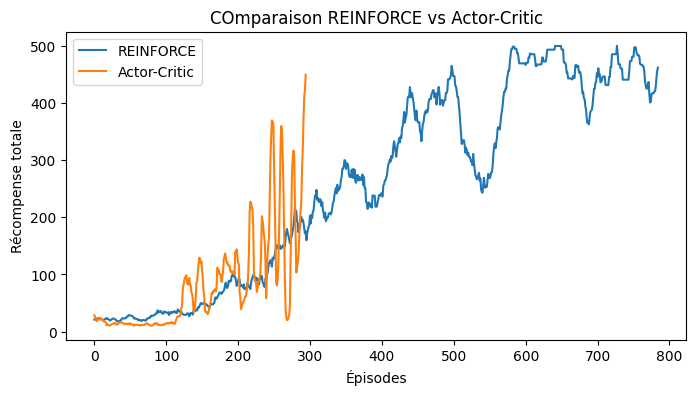

In [20]:
plot_rewards(
    list_of_rewards=[reinforce_rewards, ac_rewards],
    labels=['REINFORCE', 'Actor-Critic'],
    title="COmparaison REINFORCE vs Actor-Critic"
)

In [21]:
record_policy(reinforce_model, model_type='q', max_steps=2_000)

In [22]:
record_policy(actor_model, model_type='policy')

## 5. Deep Reinforcement learning: DQN

In [23]:
def train_dqn(episodes=500, gamma=0.99, alpha=0.001,
              eps_start=1.0, eps_min=0.05, eps_decay=0.995,
              batch_size=64, buffer_size=50000, target_update=50):

    env = gym.make('CartPole-v1')
    n_states = env.observation_space.shape[0]
    n_actions = env.action_space.n

    q_model = build_mlp(n_states, n_actions)
    target_model = build_mlp(n_states, n_actions)
    target_model.set_weights(q_model.get_weights())

    optimizer = optimizers.Adam(learning_rate=alpha)
    loss_fn = tf.keras.losses.MeanSquaredError()

    memory = deque(maxlen=buffer_size)
    rewards_history = []

    eps = eps_start

    for ep in tqdm(range(episodes), desc="Training DQN"):
        obs, info = env.reset()
        total_reward = 0
        done = False

        while not done:
            # --- Sélection d'action (ε-greedy)
            if np.random.rand() < eps:
                action = np.random.randint(n_actions)
            else:
                q_values = q_model(obs.reshape(1, -1)).numpy()
                action = int(np.argmax(q_values))

            # --- Exécution dans l’environnement
            next_obs, reward, terminated, truncated, _ = env.step(action)
            done = terminated or truncated
            memory.append((obs, action, reward, next_obs, done))
            obs = next_obs
            total_reward += reward

            # --- Entraînement par mini-lot (batch)
            if len(memory) >= batch_size:
                batch = random.sample(memory, batch_size)
                obs_batch, act_batch, rew_batch, next_batch, done_batch = map(np.array, zip(*batch))

                # cibles de Q-learning
                next_qs = target_model(next_batch).numpy()
                targets = rew_batch + gamma * (1 - done_batch) * np.max(next_qs, axis=1)

                with tf.GradientTape() as tape:
                    qs = q_model(obs_batch)
                    act_onehot = tf.one_hot(act_batch, n_actions)
                    pred = tf.reduce_sum(qs * act_onehot, axis=1)
                    loss = loss_fn(targets, pred)
                grads = tape.gradient(loss, q_model.trainable_variables)
                optimizer.apply_gradients(zip(grads, q_model.trainable_variables))

        # --- mise à jour du modèle cible
        if ep % target_update == 0:
            target_model.set_weights(q_model.get_weights())

        # --- décroissance de epsilon
        eps = max(eps_min, eps * eps_decay)
        rewards_history.append(total_reward)

    env.close()
    return q_model, rewards_history

In [24]:
dqn_model, dqn_rewards = train_dqn(episodes=800)

Training DQN: 100%|██████████| 800/800 [1:52:34<00:00,  8.44s/it]    


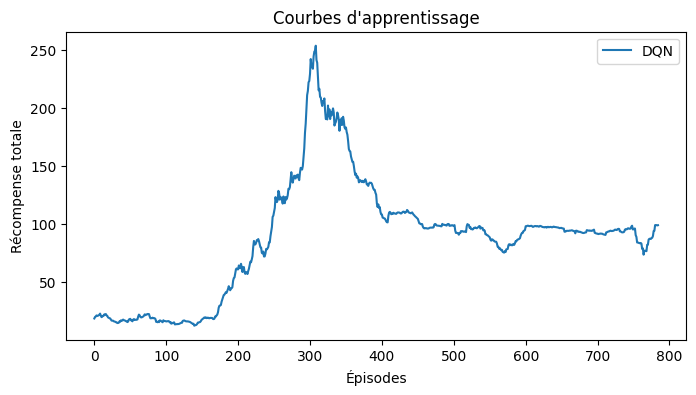

In [25]:
plot_rewards(
    list_of_rewards=[dqn_rewards],
    labels=['DQN'],
)

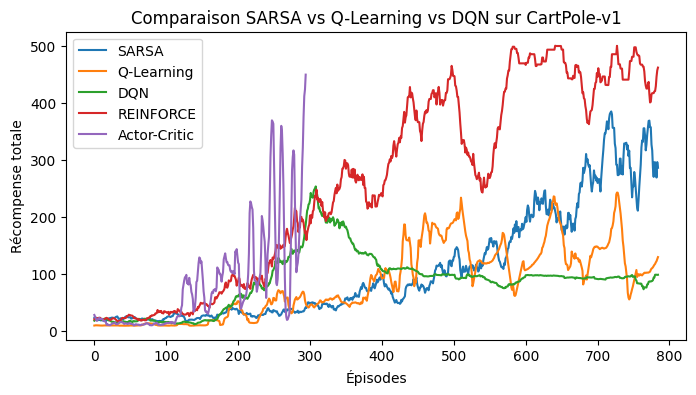

In [26]:
plot_rewards(
    list_of_rewards=[sarsa_rewards, q_rewards, dqn_rewards, reinforce_rewards, ac_rewards],
    labels=['SARSA', 'Q-Learning', 'DQN', 'REINFORCE', 'Actor-Critic'],
    title="Comparaison SARSA vs Q-Learning vs DQN sur CartPole-v1"
)

In [27]:
record_policy_sarsa_q_learning(dqn_model, model_type='q', max_steps=2_000)